# Cross Selling Problem

# Introduction

Salespeople use cross-selling and upselling strategies to generate more business from an existing customer base. In the insurance industry, cross-selling is when you sell additional insurance products to an established client.

‍Cross-selling insurance allows you to earn additional profit without the cost of searching for new leads. Additionally, you build your client relationship by staying up to date on events and changes in your clients’ lives — which might require new or greater coverage. This can lead to improved client retention.

‍However, cross-selling must be done the right way. If you aggressively push your clients to purchase products they don’t want or need, you risk losing their business.

## Solution Planning


1. Conduct an exploratory analysis to find insights about the most relevant customer attributes.
2. Develop a machine learning model to predict the probability of a customer being interested in vehicle insurance.
3. Create a rank of customers more susceptible to purchasing a new product.
4. Define metrics to evaluate different models and choose the best one.
5. Deliver an API capable of sorting customers by interest probability.

## Business Problem

**Questions to answer**
1. Find insights based on the most relevant customers attributes.
2. What percentage of customers are interested in purchasing auto insurance if the sales team make 20,000 calls?
3. What if the sales team's capacity increases to 40,000 calls?
4. How many calls does the sales team need to make to contact 80% of customers interested in acquiring a car insurance?

# 0.0. Appendix A

## i. Import Libraries

In [121]:
# Data Manipulation
import psycopg2      as pg
import pandas        as pd
import pandas.io.sql as psql
import numpy         as np

# Preprocessing data
from category_encoders            import TargetEncoder, CountEncoder
from sklearn                      import preprocessing   as pp
from sklearn                      import model_selection as ms
from sklearn.kernel_approximation import Nystroem
from sklearn.decomposition        import SparsePCA
from sklearn.decomposition        import TruncatedSVD
from scipy                        import stats

# Data Visualization
import seaborn              as     sns
import plotly.express       as     px
import plotly.graph_objects as go
from   plotly.subplots      import make_subplots
import scikitplot           as     skplot 
from   matplotlib           import pyplot    as plt
from   IPython.display      import Image
from   IPython.core.display import HTML

# Model
from sklearn                 import ensemble  as en
from sklearn                 import neighbors as nb
from sklearn.linear_model    import LogisticRegression, SGDClassifier
from sklearn                 import svm
from sklearn.ensemble        import RandomForestClassifier



# Tensorflow
import tensorflow            as     tf
from tensorflow.keras        import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.losses import SparseCategoricalCrossentropy, BinaryCrossentropy

## II. Helper Functions

In [3]:
#===========================
#  PRECISION AND RECALL @K
#===========================

def at_k( y_val, y_hat ):    
    
    df_metric = pd.DataFrame( y_val ) #response
    df_metric['predict'] = y_hat[:,1]
    df_metric = df_metric.sort_values( by='predict', ascending=False )
    df_metric['ranking'] = np.int64(np.linspace( 1, df_metric.shape[0], df_metric.shape[0]))
    df_metric = df_metric.assign( cumulative     = lambda x: (x['response'].cumsum() ) )
    df_metric = df_metric.assign( precision_at_k = lambda x: (x['cumulative']/df_metric['ranking'] ) )
    df_metric = df_metric.assign( recall_at_k    = lambda x: (x['cumulative']/df_metric['response'].sum() ) )
    df_metric = df_metric.assign( baseline       = lambda x: (x['ranking']/df_metric.shape[0] ) )
    

    return df_metric

In [4]:
#=====================
# DATA VISUALIZARION
#=====================
def jupyter_settings():
    %matplotlib inline
    
    plt.style.use( 'bmh' )
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
    
    display( HTML( '') )
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option( 'display.expand_frame_repr', False )
    
    sns.set()

jupyter_settings()

# 1.0. Data Understanding

### Variable:	Definition
- id:	Unique ID for the customer
- Gender:	Gender of the customer
- Age:	Age of the customer
- Driving_License:	0 : Customer does not have DL, 1 : Customer already has DL
- Region_Code:	Unique code for the region of the customer
- Previously_Insured:	1 : Customer already has Vehicle Insurance, 0 : Customer doesn't have Vehicle Insurance
- Vehicle_Age:	Age of the Vehicle
- Vehicle_Damage:	1 : Customer got his/her vehicle damaged in the past. 0 : Customer didn't get his/her vehicle damaged in the past.
- Annual_Premium:	The amount customer needs to pay as premium in the year
- PolicySalesChannel:	Anonymized Code for the channel of outreaching to the customer ie. Different Agents, Over Mail, Over Phone, In Person, etc.
- Vintage:	Number of Days, Customer has been associated with the company
= Response:	1 : Customer is interested, 0 : Customer is not interested

## 1.1. Collecting Initial Data

In [5]:
#===============
#  Credentials
#===============
host = 'comunidade-ds-postgres.c50pcakiuwi3.us-east-1.rds.amazonaws.com'
port = 5432
database = 'comunidadedsdb'
username = 'member'
pwd = 'cdspa'

#=================
#  Conecting AWS
#=================
conn = pg.connect(  user = username,
                    password = pwd,
                    host = host,
                    port = port,
                    database = database )

# Query and join data
query_table_users = '''
                SELECT *
                FROM pa004.users u  LEFT JOIN pa004.vehicle  v ON ( u.id = v.id )
                                    LEFT JOIN pa004.insurance i ON ( u.id = i.id )
'''

# Read on a pd DataFrame
df = psql.read_sql( query_table_users, conn )

# Remooving duplicated columns
df_raw = df.loc[:,~df.columns.duplicated()].copy()

/var/folders/2v/3xmrj4ts6psb7j4nt0tr75980000gn/T/ipykernel_746/2691599613.py:27: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = psql.read_sql( query_table_users, conn )


In [6]:
df_raw.head()

,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response
0,7,Male,23,11.0,152.0,1,< 1 Year,Yes,0,23367.0,249,0
1,13,Female,41,15.0,14.0,1,1-2 Year,No,1,31409.0,221,0
2,18,Female,25,35.0,152.0,1,< 1 Year,No,1,46622.0,299,0
3,31,Female,26,8.0,160.0,1,< 1 Year,No,0,2630.0,136,0
4,39,Male,45,8.0,124.0,1,1-2 Year,Yes,0,42297.0,264,0


## 1.2. Describe Data

In [7]:
df_raw.head()

,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response
0,7,Male,23,11.0,152.0,1,< 1 Year,Yes,0,23367.0,249,0
1,13,Female,41,15.0,14.0,1,1-2 Year,No,1,31409.0,221,0
2,18,Female,25,35.0,152.0,1,< 1 Year,No,1,46622.0,299,0
3,31,Female,26,8.0,160.0,1,< 1 Year,No,0,2630.0,136,0
4,39,Male,45,8.0,124.0,1,1-2 Year,Yes,0,42297.0,264,0


### 1.2.1. Data Dimensions

In [8]:
# Data Dimensions
print( 'Number of records  : {}'.format( df_raw.shape[0] ) )
print( 'Number of Features : {}'.format( df_raw.shape[1] ) )

Number of records  : 381109
Number of Features : 12


### 1.2.2. Data Type

In [9]:
df_raw.dtypes

id                        int64
gender                   object
age                       int64
region_code             float64
policy_sales_channel    float64
driving_license           int64
vehicle_age              object
vehicle_damage           object
previously_insured        int64
annual_premium          float64
vintage                   int64
response                  int64
dtype: object

#### Transforming type

In [10]:
df1 = df_raw.copy()

df1['region_code'] = df1['region_code'].map({'11.0':'cod11', 15.0:'cod15', 'cod35':35.0, 8.0:'cod08', 28.0:'cod28', 39.0:'cod39', 29.0:'cod29', 30.0:'cod30', 25.0:'cod25', 22.0:'cod22', 36.0:'cod36',
       0.0:'cod00', 26.0:'cod26', 6.0:'cod06', 48.0:'cod48', 47.0:'cod47', 33.0:'cod33', 41.0:'cod41', 46.0:'cod46', 43.0:'cod43', 2.0:'cod02', 37.0:'cod37',
       40.0:'cod40', 4.0:'cod04', 10.0:'cod10', 18.0:'cod18', 9.0:'cod09', 3.0:'cod03', 50.0:'cod50', 32.0:'cod32', 24.0:'cod24', 27.0:'cod27', 34.0:'cod34',
       21.0:'cod21', 45.0:'cod45', 12.0:'cod12', 5.0:'cod05', 49.0:'cod49', 14.0:'cod14', 16.0:'cod16', 13.0:'cod13', 31.0:'cod31', 23.0:'cod23', 1.0:'cod01',
       42.0:'cod42', 7.0:'cod07', 17.0:'cod17', 44.0:'cod44', 19.0:'cod19', 38.0:'cod38', 20.0:'cod20', 52.0:'cod52', 51.0:'cod51'})

In [11]:
# float to int64
df1['region_code']          = df_raw['region_code'         ].astype( 'object' )
df1['policy_sales_channel'] = df_raw['policy_sales_channel'].astype( 'object' )
df1['annual_premium']       = df_raw['annual_premium'      ].astype( 'int64' )
df1['driving_license']      = df_raw['driving_license'     ].astype( 'object' )

In [12]:
df1.head()

,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response
0,7,Male,23,11.0,152.0,1,< 1 Year,Yes,0,23367,249,0
1,13,Female,41,15.0,14.0,1,1-2 Year,No,1,31409,221,0
2,18,Female,25,35.0,152.0,1,< 1 Year,No,1,46622,299,0
3,31,Female,26,8.0,160.0,1,< 1 Year,No,0,2630,136,0
4,39,Male,45,8.0,124.0,1,1-2 Year,Yes,0,42297,264,0


In [13]:

df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 381109 entries, 0 to 381108
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   id                    381109 non-null  int64 
 1   gender                381109 non-null  object
 2   age                   381109 non-null  int64 
 3   region_code           381109 non-null  object
 4   policy_sales_channel  381109 non-null  object
 5   driving_license       381109 non-null  object
 6   vehicle_age           381109 non-null  object
 7   vehicle_damage        381109 non-null  object
 8   previously_insured    381109 non-null  int64 
 9   annual_premium        381109 non-null  int64 
 10  vintage               381109 non-null  int64 
 11  response              381109 non-null  int64 
dtypes: int64(6), object(6)
memory usage: 34.9+ MB


### 1.2.3. Missing Values

No missing values found

In [14]:
df1.isna().sum()

id                      0
gender                  0
age                     0
region_code             0
policy_sales_channel    0
driving_license         0
vehicle_age             0
vehicle_damage          0
previously_insured      0
annual_premium          0
vintage                 0
response                0
dtype: int64

## 1.3. Descriptive Statistics

In [15]:
df1.describe().T

,count,mean,std,min,25%,50%,75%,max
id,381109.0,190555.000000,110016.836208,1.0,95278.0,190555.0,285832.0,381109.0
age,381109.0,38.822584,15.511611,20.0,25.0,36.0,49.0,85.0
previously_insured,381109.0,0.458210,0.498251,0.0,0.0,0.0,1.0,1.0
annual_premium,381109.0,30564.389581,17213.155057,2630.0,24405.0,31669.0,39400.0,540165.0
vintage,381109.0,154.347397,83.671304,10.0,82.0,154.0,227.0,299.0
response,381109.0,0.122563,0.327936,0.0,0.0,0.0,0.0,1.0


# 2.0. ~~Feature Engineering and Transformations~~

In [16]:
df2 = df1.copy()

#### Meaningless Feature
- id:	Unique ID for the customer

#### Categorical Feature
- Gender:	Gender of the customer
- Driving_License:	0 : Customer does not have DL, 1 : Customer already has DL
- Vehicle_Age:	Age of the Vehicle
- Region_Code:	Unique code for the region of the customer
- Previously_Insured:	1 : Customer already has Vehicle Insurance, 0 : Customer doesn't have Vehicle Insurance
- Vehicle_Damage:	1 : Customer got his/her vehicle damaged in the past. 0 : Customer didn't get his/her vehicle damaged in the past.
- PolicySalesChannel:	Anonymized Code for the channel of outreaching to the customer ie. Different Agents, Over Mail, Over Phone, In Person, etc.

### Numeciral Feature
- Age:	Age of the customer
- Annual_Premium:	The amount customer needs to pay as premium in the year
- Vintage:	Number of Days, Customer has been associated with the company

### Target Feature
- Response:	1 : Customer is interested, 0 : Customer is not interested

## 2.1. Categorical Feature

In [17]:
df2.head()

,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response
0,7,Male,23,11.0,152.0,1,< 1 Year,Yes,0,23367,249,0
1,13,Female,41,15.0,14.0,1,1-2 Year,No,1,31409,221,0
2,18,Female,25,35.0,152.0,1,< 1 Year,No,1,46622,299,0
3,31,Female,26,8.0,160.0,1,< 1 Year,No,0,2630,136,0
4,39,Male,45,8.0,124.0,1,1-2 Year,Yes,0,42297,264,0


# 3.0. Exploratory Analysis

In [18]:
df3 = df2.copy()

### Traget Feature

In [19]:
aux = df3.groupby('response').count().reset_index()

fig = px.pie(aux, values='id', names='response', title='Proportion')
fig.show()

## 3.1. Categorical Feature

### 3.1.1. Gender

In [20]:
aux = df3.groupby(['response','gender']).count().reset_index()

In [21]:
fig = px.bar(aux, x='response', y='id', color='gender', title='Response by Gender')
fig.show()

### 3.1.2. Driving License

In [22]:
aux0 = df3[df3['driving_license']==0].groupby(['response','driving_license']).count().reset_index()
aux1 = df3[df3['driving_license']==1].groupby(['response','driving_license']).count().reset_index()

In [23]:
px.bar( aux0, x='response', y='id', title='Response when dont have license' )

In [24]:
px.bar( aux1, x='response', y='id', title='Response by license' )


### 3.1.3. Vehicle Age

In [25]:
aux = df3.groupby(['response','vehicle_age']).count().reset_index()

fig = px.bar(aux, x='response', y='id', color='vehicle_age', title='Response by Vehicle Age')
fig.show()

In [26]:
fig = px.bar(aux, x='vehicle_age', y='id', color='response', title='Vehicle Age by response')
fig.show()

### 3.1.4. Region Code

In [27]:
aux = df3.groupby(['response','region_code'])['id'].count().reset_index()

fig = px.bar(aux, x='region_code', y='id', color='response', title='Response by region')
fig.show()

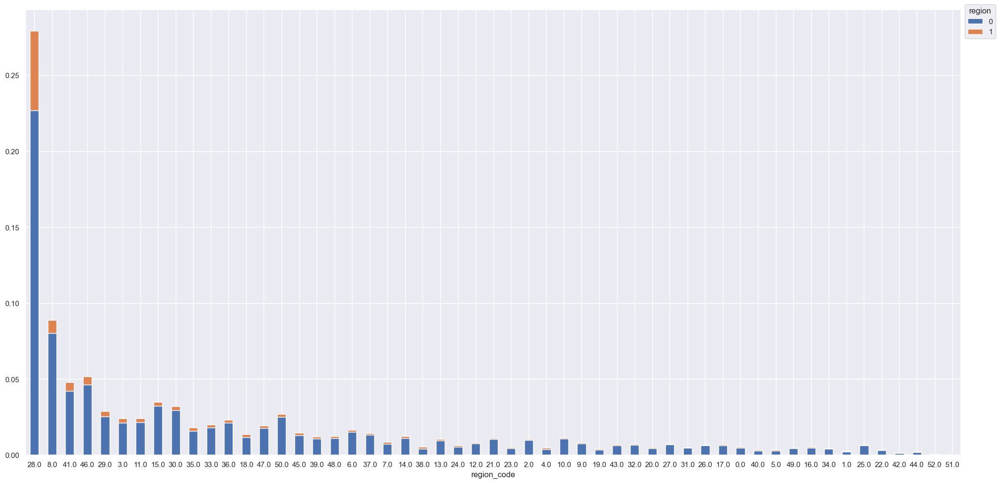

In [28]:
ct = pd.crosstab(df3['region_code'], df3['response'], normalize=True).sort_values( by= 1, ascending=False )

ax = ct.plot(kind='bar', stacked=True, rot=0)
ax.legend(title='region', bbox_to_anchor=(1, 1.02), loc='upper left')

<AxesSubplot: xlabel='region_code'>

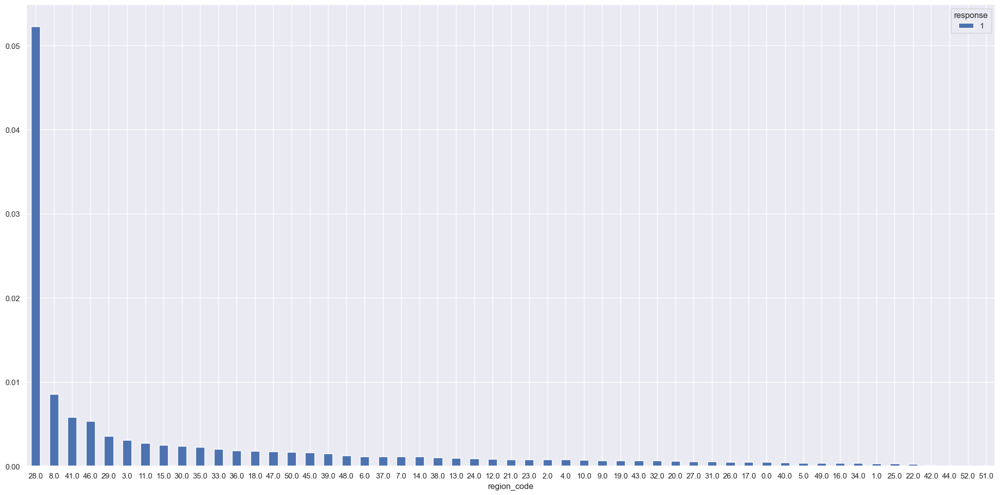

In [29]:
ct = pd.crosstab(df3['region_code'], df3['response'], normalize=True).sort_values( by= 1, ascending=False )
ct = ct.sort_values( by=1, ascending=False )

ct[[1]].plot(kind='bar', stacked=True, rot=0)

In [30]:
ct.reset_index()

response,region_code,0,1
0,28.0,0.226964,0.052261
1,8.0,0.080344,0.008546
2,41.0,0.042085,0.005836
3,46.0,0.046488,0.005332
4,29.0,0.025452,0.003582
5,3.0,0.021175,0.003099
6,11.0,0.021493,0.002732
7,15.0,0.032405,0.002514
8,30.0,0.029627,0.002362
9,35.0,0.015946,0.002270


<AxesSubplot: xlabel='region_code'>

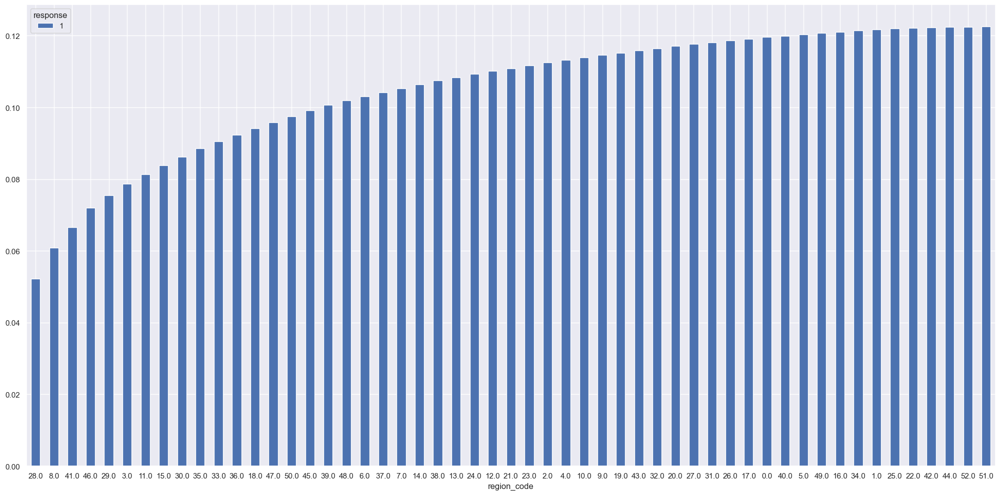

In [31]:
ct = pd.crosstab(df3['region_code'], df3['response'], normalize=True).sort_values( by= 1, ascending=False )
ct[[0,1]] = ct[[0,1]].cumsum()

ct[[1]].plot(kind='bar', stacked=True, rot=0)


In [32]:
ct.reset_index()

response,region_code,0,1
0,28.0,0.226964,0.052261
1,8.0,0.307308,0.060807
2,41.0,0.349393,0.066642
3,46.0,0.395881,0.071974
4,29.0,0.421334,0.075556
5,3.0,0.442509,0.078655
6,11.0,0.464001,0.081386
7,15.0,0.496407,0.083900
8,30.0,0.526033,0.086261
9,35.0,0.541979,0.088531


#### Interess Percentage By Region

In [33]:
df_ct = pd.crosstab(df3['region_code'], df3['response'], normalize=False).sort_values( by= 1, ascending=False )
df_ct['% SIM'] = df_ct[1]/( df_ct[0] + df_ct[1] )
df_ct['Total'] = ( df_ct[0] + df_ct[1] )
df_ct = df_ct.sort_values( by = '% SIM', ascending=False)
df_ct = df_ct.reset_index()


In [34]:

#df_ct[['% SIM']].plot(kind='bar', stacked=True, rot=0)
fig = px.bar(df_ct, x='region_code', y='% SIM', title='Interess ''%'' by region')
fig.show()

#### Cumulative Interess Percentage by region

In [35]:
df_ct_cum = pd.crosstab(df3['region_code'], df3['response'], normalize=False).sort_values( by= 1, ascending=False )
df_ct_cum['% SIM'] = df_ct_cum[1]/( df_ct_cum[0] + df_ct_cum[1] )
df_ct_cum = df_ct_cum.sort_values( by='% SIM', ascending=False )
df_ct_cum['1_cum'] = ( df_ct_cum[1] ).cumsum()
df_ct_cum['Total_cum'] = ( df_ct_cum[0] + df_ct_cum[1] ).cumsum()
df_ct_cum['% Total_cum'] = ( df_ct_cum[0] + df_ct_cum[1] ).cumsum()/381109
df_ct_cum['% SIM_cum'] = df_ct_cum['1_cum']/( df_ct_cum['Total_cum'] )
df_ct_cum = df_ct_cum.sort_values( by = '% SIM_cum', ascending=False)
df_ct_cum = df_ct_cum.reset_index().reset_index()
df_ct_cum


response,index,region_code,0,1,% SIM,1_cum,Total_cum,% Total_cum,% SIM_cum
0,0,38.0,1637,389,0.192004,389,2026,0.005316,0.192004
1,1,28.0,86498,19917,0.187163,20306,108441,0.284541,0.187254
2,2,19.0,1285,250,0.162866,20556,109976,0.288568,0.186914
3,3,4.0,1516,285,0.158245,20841,111777,0.293294,0.186452
4,4,23.0,1660,300,0.153061,21141,113737,0.298437,0.185876
5,5,51.0,155,28,0.153005,21169,113920,0.298917,0.185823
6,6,24.0,2073,342,0.141615,21511,116335,0.305254,0.184906
7,7,7.0,2847,432,0.131747,21943,119614,0.313858,0.183448
8,8,18.0,4475,678,0.131574,22621,124767,0.327379,0.181306
9,9,3.0,8070,1181,0.127662,23802,134018,0.351653,0.177603


In [36]:
px.line(df_ct_cum, y='% SIM_cum', x=df_ct_cum['Total_cum'], title='Interess Percentage VS Number of customers by region')

<AxesSubplot: xlabel='index', ylabel='% SIM_cum'>

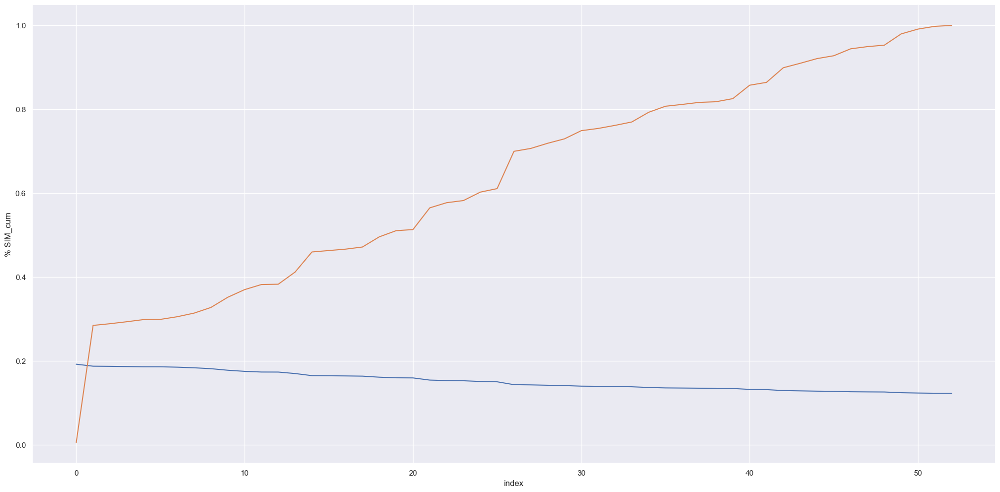

In [37]:
sns.lineplot( data=df_ct_cum, y='% SIM_cum', x='index' )
sns.lineplot( data=df_ct_cum, y='% Total_cum', x='index' )

In [38]:
selected_ragions = df_ct_cum['region_code'].iloc[0:8].tolist()

### 3.1.5. Priviously Insured

In [39]:
aux = df3.groupby(['response','previously_insured'])['id'].count().reset_index()

fig = px.bar(aux, x='response', y='id', color='previously_insured', title='Response by Previously Insured')
fig.show()

In [40]:
aux

,response,previously_insured,id
0,0,0,159929
1,0,1,174470
2,1,0,46552
3,1,1,158


### 3.1.6. Vehicle Damage

In [41]:
aux = df3.groupby(['response','vehicle_damage'])['id'].count().reset_index()

fig = px.bar(aux, x='response', y='id', color='vehicle_damage', title='Response by Vehicle Damage')
fig.show()

In [42]:
aux

,response,vehicle_damage,id
0,0,No,187714
1,0,Yes,146685
2,1,No,982
3,1,Yes,45728


### 3.1.7. Policy Sales Channel

In [43]:
aux = df3.groupby(['response','policy_sales_channel'])['id'].count().reset_index()

fig = px.bar(aux, x='policy_sales_channel', y='id', color='response', title='Response by Policy Sales Channel')
fig.show()

In [44]:
df_ct_cum = pd.crosstab(df3['policy_sales_channel'], df3['response'], normalize=False).sort_values( by= 1, ascending=False )
df_ct_cum['% SIM'] = df_ct_cum[1]/( df_ct_cum[0] + df_ct_cum[1] )
df_ct_cum = df_ct_cum.sort_values( by='% SIM', ascending=False )
df_ct_cum['1_cum'] = ( df_ct_cum[1] ).cumsum()
df_ct_cum['Total_cum'] = ( df_ct_cum[0] + df_ct_cum[1] ).cumsum()
df_ct_cum['% Total_cum'] = ( df_ct_cum[0] + df_ct_cum[1] ).cumsum()/381109
df_ct_cum['% SIM_cum'] = df_ct_cum['1_cum']/( df_ct_cum['Total_cum'] )
df_ct_cum = df_ct_cum.sort_values( by = '% SIM_cum', ascending=False)
df_ct_cum = df_ct_cum.reset_index().reset_index()
df_ct_cum

response,index,policy_sales_channel,0,1,% SIM,1_cum,Total_cum,% Total_cum,% SIM_cum
0,0,123.0,0,1,1.000000,1,1,0.000003,1.000000
1,1,43.0,0,1,1.000000,2,2,0.000005,1.000000
2,2,28.0,2,1,0.333333,3,5,0.000013,0.600000
3,3,27.0,2,1,0.333333,4,8,0.000021,0.500000
4,4,36.0,35,17,0.326923,21,60,0.000157,0.350000
5,5,155.0,839,395,0.320097,416,1294,0.003395,0.321484
6,6,163.0,2013,880,0.304183,1296,4187,0.010986,0.309529
7,7,3.0,364,159,0.304015,1455,4710,0.012359,0.308917
8,8,121.0,45,19,0.296875,1474,4774,0.012527,0.308756
9,9,80.0,10,4,0.285714,1478,4788,0.012563,0.308688


In [45]:
px.line(df_ct_cum, y='% SIM_cum', x=df_ct_cum['Total_cum'], title='Interess Percentage VS Number of customers by channel')

<AxesSubplot: xlabel='index', ylabel='% SIM_cum'>

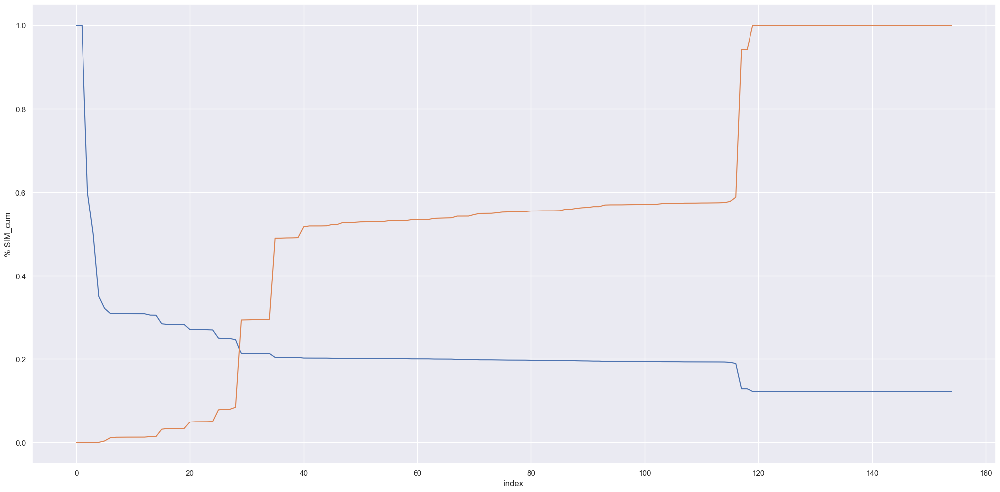

In [46]:
sns.lineplot( data=df_ct_cum, y='% SIM_cum', x='index' )
sns.lineplot( data=df_ct_cum, y='% Total_cum', x='index' )

In [47]:
selected_channels = df_ct_cum['policy_sales_channel'].iloc[6:116].tolist()

## 3.2. Numerical Feature

### 3.2.1. Age

In [48]:
fig = px.histogram( df3, x='age', color='response' )
fig.update_traces(opacity=0.5)
fig.show()

In [49]:
fig = go.Figure()

fig.add_trace( go.Histogram( x=df3[df3['response']==0]['age'] ) )
fig.add_trace( go.Histogram( x=df3[df3['response']==1]['age'] ) )
fig.show()

### 3.2.2. Annual_Premium
The amount customer needs to pay as premium in the year


In [50]:
aux = df3
fig = go.Figure()

fig.add_trace( go.Histogram( x=aux[aux['response']==0]['annual_premium'] ) )
fig.add_trace( go.Histogram( x=aux[aux['response']==1]['annual_premium'] ) )
fig.update_layout(barmode='stack')
fig.show()

In [51]:
aux = df3[(df3['annual_premium']>3000)]

fig = px.pie(aux, values='annual_premium', names='response', title='Proportion for premium < 3000')
fig.show()

In [52]:
aux = df3[(df3['annual_premium']>3000) & (df3['annual_premium']<100000)]
fig = go.Figure()

fig.add_trace( go.Histogram( x=aux[aux['response']==0]['annual_premium'] ) )
fig.add_trace( go.Histogram( x=aux[aux['response']==1]['annual_premium'] ) )

fig.show()

In [53]:
aux = df3[(df3['annual_premium']>0) & (df3['annual_premium']<3000)]

fig = px.pie(aux, values='annual_premium', names='response', title='Proportion for premium < 3000')
fig.show()

### 3.2.3. Vintage
Number of Days, Customer has been associated with the company

In [54]:
fig = go.Figure()

fig.add_trace( go.Histogram( x=aux[aux['response']==0]['vintage'] ) )
fig.add_trace( go.Histogram( x=aux[aux['response']==1]['vintage'] ) )

fig.show()

## 3.3. Bivariate Analysis

### 3.3.1. Age & Vintage

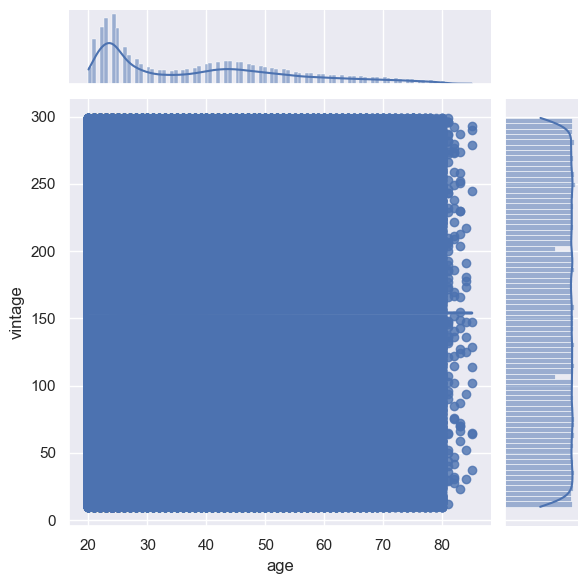

In [55]:
sns.jointplot(x=df3['age'],y=df3['vintage'], kind='reg')

### 3.3.2. Age & Annual premium

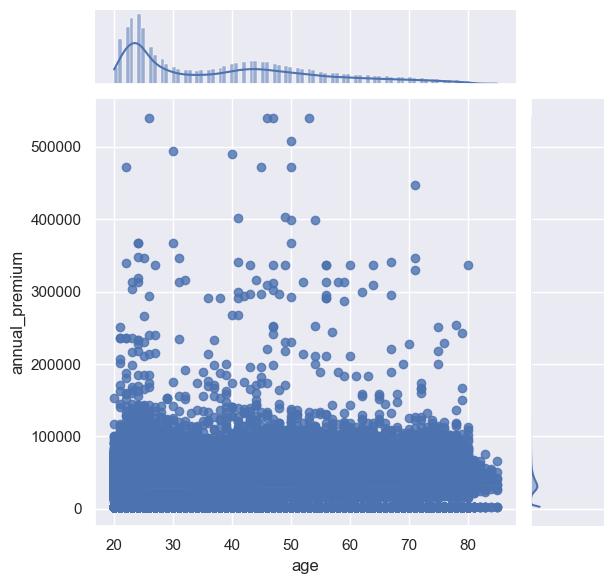

In [56]:
sns.jointplot(x=df3['age'],y=df3['annual_premium'], kind='reg')

### 3.3.3. Vintage & Annual Premium

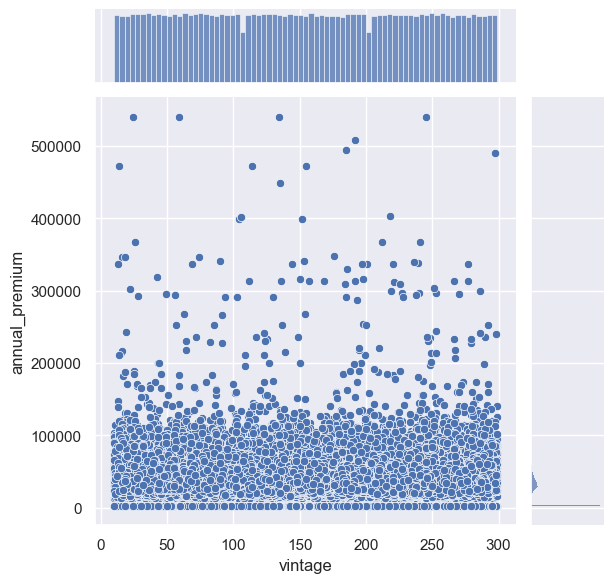

In [57]:
sns.jointplot(x=df3['vintage'],y=df3['annual_premium'])

### 3.3.4. Select Attribute Best Section

- The Sales Channels in _selected_channels_ have a higher proportion (19%) of interested customers than the entire population (12%)
- The Sales Channels in _selected_channels_ have 219.088 customers

- Regions [38.0, 28.0] also have a higher proportion (19%) of interested customers than the entire population (12%)
- Regions [38.0, 28.0] have 108.441 customers.

#### Check if combining these two intervals leads to an even higher proportion.

In [58]:
aux334 = df3[df3['policy_sales_channel'].isin(selected_channels)]  # 219.088 customers
#aux334 = aux334[(aux334['region_code']==38.0) | (aux334['region_code']==28.0)]                   
aux334 = aux334[aux334['region_code'].isin(selected_ragions)]                   
#aux334 = df3[(df3['region_code']==38.0) | (df3['region_code']==28.0)]                   

In [59]:
aux334.describe().T

,count,mean,std,min,25%,50%,75%,max
id,100232.0,190367.092705,110209.515092,1.0,95046.75,190388.5,285581.75,381102.0
age,100232.0,49.233189,12.967989,20.0,41.00,47.0,58.00,85.0
previously_insured,100232.0,0.247007,0.431273,0.0,0.00,0.0,0.00,1.0
annual_premium,100232.0,37120.757123,19048.378321,2630.0,29644.75,37749.0,46191.00,540165.0
vintage,100232.0,154.287064,83.727720,10.0,81.00,154.0,227.00,299.0
response,100232.0,0.209474,0.406935,0.0,0.00,0.0,0.00,1.0


In [60]:
aux334_ = aux334.groupby('response').count().reset_index()

fig = px.pie(aux334_, values='id', names='response', title='Proportion on selected intervals')
fig.show()

## 3.4. Correlation Analysis

In [61]:
correlation = np.abs(df3.drop('id', axis=1).corr( method= 'pearson' ))

fig = px.imshow(correlation, text_auto=True, title='Correlation heatmap')
fig.show()

/var/folders/2v/3xmrj4ts6psb7j4nt0tr75980000gn/T/ipykernel_746/1140488853.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



In [62]:
correlation = (aux334.drop('id', axis=1).corr( method= 'pearson' ))

fig = px.imshow(correlation, text_auto=True, title='Correlation heatmap')
fig.show()

/var/folders/2v/3xmrj4ts6psb7j4nt0tr75980000gn/T/ipykernel_746/4055418994.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



In [63]:
aux334.describe().T

,count,mean,std,min,25%,50%,75%,max
id,100232.0,190367.092705,110209.515092,1.0,95046.75,190388.5,285581.75,381102.0
age,100232.0,49.233189,12.967989,20.0,41.00,47.0,58.00,85.0
previously_insured,100232.0,0.247007,0.431273,0.0,0.00,0.0,0.00,1.0
annual_premium,100232.0,37120.757123,19048.378321,2630.0,29644.75,37749.0,46191.00,540165.0
vintage,100232.0,154.287064,83.727720,10.0,81.00,154.0,227.00,299.0
response,100232.0,0.209474,0.406935,0.0,0.00,0.0,0.00,1.0


# 4.0. Feature Engineering

In [77]:
df4 = df3.copy()

## 4.1. New Features

### 4.1.1. Decompose _annual_premium_ into two features:


#### Basic Plan (categorical)

- when annual premium is lower than 3500

In [78]:
df4['premium_basic'] = df4['annual_premium'].apply( lambda x : 1 if x < 3500 else 0 )

In [79]:
df4.head()

,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response,premium_basic
0,7,Male,23,11.0,152.0,1,< 1 Year,Yes,0,23367,249,0,0
1,13,Female,41,15.0,14.0,1,1-2 Year,No,1,31409,221,0,0
2,18,Female,25,35.0,152.0,1,< 1 Year,No,1,46622,299,0,0
3,31,Female,26,8.0,160.0,1,< 1 Year,No,0,2630,136,0,1
4,39,Male,45,8.0,124.0,1,1-2 Year,Yes,0,42297,264,0,0


#### Regular Plan (numerical)

- when annual premium is greater than 3500
- log applied

In [80]:
df4['premium_regular'] = df4['annual_premium'].apply( lambda x : x if x > 5000 else 0.0001 )
#df4['premium_regular'] = stats.boxcox(df4[df4['premium_regular'] > 3500 ].loc[:,'premium_regular'])[0]

In [81]:
aux = np.log1p( df4['premium_regular'] )
fig = px.histogram( aux )
fig.show()

## 4.2. Encoding & Scaling

### 4.1.1. region_code

In [125]:
region_code_encoder = TargetEncoder()
df4['region_code'] = region_code_encoder.fit_transform(  df4['region_code'],df4['response'] )

/Users/puppim/Documents/GitHub/Data-Science-Portifolio/Cross_Selling_Insurance/.venv/lib/python3.9/site-packages/category_encoders/target_encoder.py:122: FutureWarning:

Default parameter min_samples_leaf will change in version 2.6.See https://github.com/scikit-learn-contrib/category_encoders/issues/327

/Users/puppim/Documents/GitHub/Data-Science-Portifolio/Cross_Selling_Insurance/.venv/lib/python3.9/site-packages/category_encoders/target_encoder.py:127: FutureWarning:

Default parameter smoothing will change in version 2.6.See https://github.com/scikit-learn-contrib/category_encoders/issues/327



### 4.1.2. policy_sales_channel

In [126]:
policy_sales_channel_encoder = TargetEncoder()
df4['policy_sales_channel'] = policy_sales_channel_encoder.fit_transform(  df4['policy_sales_channel'],df4['response'] )

/Users/puppim/Documents/GitHub/Data-Science-Portifolio/Cross_Selling_Insurance/.venv/lib/python3.9/site-packages/category_encoders/target_encoder.py:122: FutureWarning:

Default parameter min_samples_leaf will change in version 2.6.See https://github.com/scikit-learn-contrib/category_encoders/issues/327

/Users/puppim/Documents/GitHub/Data-Science-Portifolio/Cross_Selling_Insurance/.venv/lib/python3.9/site-packages/category_encoders/target_encoder.py:127: FutureWarning:

Default parameter smoothing will change in version 2.6.See https://github.com/scikit-learn-contrib/category_encoders/issues/327



### 4.1.3. driving_license

### 4.1.2. Vehicle Age Encoding

Correlate the vehicle age bin and the proportion of response:

In [82]:
pd.crosstab( df4['response'], df4['vehicle_age'], normalize='columns', margins=True, margins_name='Total' )

vehicle_age,1-2 Year,< 1 Year,> 2 Years,Total
response,,,,
0,0.826245,0.956295,0.706254,0.877437
1,0.173755,0.043705,0.293746,0.122563


Map transformation

In [83]:
df4['vehicle_age'] = df4['vehicle_age'].map({'1-2 Year':0.174, '< 1 Year':0.044, '> 2 Years':0.294})

In [84]:
df4.head()

,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response,premium_basic,premium_regular
0,7,Male,23,11.0,152.0,1,0.044,Yes,0,23367,249,0,0,23367.0000
1,13,Female,41,15.0,14.0,1,0.174,No,1,31409,221,0,0,31409.0000
2,18,Female,25,35.0,152.0,1,0.044,No,1,46622,299,0,0,46622.0000
3,31,Female,26,8.0,160.0,1,0.044,No,0,2630,136,0,1,0.0001
4,39,Male,45,8.0,124.0,1,0.174,Yes,0,42297,264,0,0,42297.0000


### 4.2.3. Age bins

In [85]:
# create a bin list
bins = list( np.arange( 20 ,90 ,10 ) )

# apply cut func. on bin's list 
df4['age_bins'] = pd.cut( df4['age'], bins=bins )

In [86]:
aux = df4.groupby(['response','age_bins']).count().reset_index()

#fig = px.bar(aux, x='age_bins', y='response', title='Interess ''%'' by region')
#fig.show()

### 4.2.4. Gender Encoding

In [87]:
df4['gender'] = df4['gender'].map({'Female':1, 'Male':0})

In [88]:
df4.head()

,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response,premium_basic,premium_regular,age_bins
0,7,0,23,11.0,152.0,1,0.044,Yes,0,23367,249,0,0,23367.0000,"(20, 30]"
1,13,1,41,15.0,14.0,1,0.174,No,1,31409,221,0,0,31409.0000,"(40, 50]"
2,18,1,25,35.0,152.0,1,0.044,No,1,46622,299,0,0,46622.0000,"(20, 30]"
3,31,1,26,8.0,160.0,1,0.044,No,0,2630,136,0,1,0.0001,"(20, 30]"
4,39,0,45,8.0,124.0,1,0.174,Yes,0,42297,264,0,0,42297.0000,"(40, 50]"


### 4.2.5. Demage Encoding

In [89]:
df4['vehicle_damage'] = df4['vehicle_damage'].map({'Yes':1, 'No':0})

In [90]:
df4.head()

,id,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured,annual_premium,vintage,response,premium_basic,premium_regular,age_bins
0,7,0,23,11.0,152.0,1,0.044,1,0,23367,249,0,0,23367.0000,"(20, 30]"
1,13,1,41,15.0,14.0,1,0.174,0,1,31409,221,0,0,31409.0000,"(40, 50]"
2,18,1,25,35.0,152.0,1,0.044,0,1,46622,299,0,0,46622.0000,"(20, 30]"
3,31,1,26,8.0,160.0,1,0.044,0,0,2630,136,0,1,0.0001,"(20, 30]"
4,39,0,45,8.0,124.0,1,0.174,1,0,42297,264,0,0,42297.0000,"(40, 50]"


### 4.2.6. Region Code

In [91]:
count_encoder_region = CountEncoder()
df4['region_code'] = count_encoder_region.fit_transform( df4['region_code'], df4['response'] )
mms_region = pp.MinMaxScaler()
df4['region_code'] = mms_region.fit_transform(df4[['region_code']].values)

# 5.0. Data Preparation

In [92]:
df5 = df_raw.copy()

## 5.1. Def function

In [93]:
def data_prep ( df ):

    # GENDER
    df['gender'] = df['gender'].map({'Female':1, 'Male':0})

    # VEHICLE DEMAGE
    df['vehicle_damage'] = df['vehicle_damage'].map({'Yes':1, 'No':0})
    
    # AGE
    mms_age = pp.MinMaxScaler()
    df['age'] = mms_age.fit_transform(df[['age']].values) 
    
    # VINTAGE
    mms_vintage = pp.MinMaxScaler()
    df['vintage'] = mms_age.fit_transform(df[['vintage']].values)

    # REGION CODE
    count_encoder_region = CountEncoder()
    df['region_code'] = count_encoder_region.fit_transform( df['region_code'], df['response'] )
    mms_region = pp.MinMaxScaler()
    df['region_code'] = mms_region.fit_transform(df[['region_code']].values)
    
    # POLICY SALES CHANNEL
    target_encoder_channel = TargetEncoder()
    df['policy_sales_channel'] = target_encoder_channel.fit_transform( df['policy_sales_channel'], df['response'] )
    mms_channel = pp.MinMaxScaler()
    df['policy_sales_channel'] = mms_channel.fit_transform(df[['policy_sales_channel']].values)

    # VEHICLE AGE
    df['vehicle_age_new'] = df['vehicle_age'].map({'1-2 Year':0.174, '< 1 Year':0.044, '> 2 Years':0.294}) 
    df = pd.get_dummies( df, prefix='vehicle_age', columns=['vehicle_age'] )

    # Sales Channel Filter
    # selected_channels = [163.0, 3.0,  121.0, 80.0,  101.0, 81.0,  87.0, 158.0, 90.0, 157.0, 31.0, 2.0, 100.0,
    # 68.0, 154.0, 150.0, 106.0, 53.0, 136.0, 156.0, 4.0, 57.0, 25.0, 26.0, 44.0, 42.0, 59.0, 94.0, 10.0,
    # 124.0, 17.0, 147.0, 56.0, 91.0, 122.0, 12.0, 69.0, 62.0, 54.0, 55.0, 45.0, 13.0, 49.0, 89.0, 23.0,
    # 35.0, 40.0, 111.0, 145.0, 24.0, 114.0, 78.0, 47.0, 29.0, 103.0, 86.0, 92.0, 125.0, 109.0, 116.0, 131.0,
    # 7.0, 58.0, 20.0, 30.0, 52.0, 93.0, 148.0, 60.0, 14.0, 9.0, 39.0, 37.0, 138.0, 61.0, 32.0, 128.0,
    # 110.0, 130.0, 139.0, 11.0, 135.0, 15.0, 16.0, 19.0, 120.0, 51.0, 8.0, 21.0, 73.0, 97.0, 127.0, 129.0,
    # 65.0, 113.0, 140.0, 132.0, 153.0, 88.0, 64.0, 66.0, 22.0, 63.0, 48.0, 119.0, 98.0, 133.0, 107.0, 18.0, 1.0]
    #df = df[df['policy_sales_channel'].isin(selected_channels)]             
    
    
    # region code Filter
    #selected_ragions = [38.0, 28.0, 19.0, 4.0, 23.0, 51.0, 24.0, 7.0]
    #df = df[df['region_code'].isin(selected_ragions)]
    

    # Feature Engineering
    df['premium_basic'] = df['annual_premium'].apply( lambda x : 1 if x < 3500 else 0 )
    df['premium_regular'] = np.log1p( df['annual_premium'].apply( lambda x : x if x > 5000 else 0.0001 ) )
    df['age_bins'] = pd.cut( df['age'], bins=list( np.arange( 18 ,100 ,10 ) ) ).astype(str).map(
                     {'(18, 28]':0.041, '(28, 38]':0.186, '(38, 48]':0.404,
                      '(48, 58]':0.231, '(58, 68]':0.091, '(68, 78]':0.042, 
                      '(78, 88]':0.003 } )
    
    # ANNUAL PREMIUM
    ss = pp.StandardScaler()
    df['annual_premium'] = ss.fit_transform( df[['annual_premium']].values )
   

    # fillna
    df = df.fillna( 0 ) 
    # Feature Selection
    #col_selected = ['premium_regular', 'vintage', 'vehicle_damage', 'previously_insured', 'response']
    #df = df.drop( ['id', 'age', 'region_code', 'policy_sales_channel', 'annual_premium'], axis=1 )
    df = df.drop( ['id'], axis=1 )
    #df = df[col_selected]
    
    return df
    

In [94]:
df5 = data_prep( df5 )

/Users/puppim/Documents/GitHub/Data-Science-Portifolio/Cross_Selling_Insurance/.venv/lib/python3.9/site-packages/category_encoders/target_encoder.py:122: FutureWarning:

Default parameter min_samples_leaf will change in version 2.6.See https://github.com/scikit-learn-contrib/category_encoders/issues/327

/Users/puppim/Documents/GitHub/Data-Science-Portifolio/Cross_Selling_Insurance/.venv/lib/python3.9/site-packages/category_encoders/target_encoder.py:127: FutureWarning:

Default parameter smoothing will change in version 2.6.See https://github.com/scikit-learn-contrib/category_encoders/issues/327



In [95]:
df5.head()

,gender,age,region_code,policy_sales_channel,driving_license,vehicle_damage,previously_insured,annual_premium,vintage,response,vehicle_age_new,vehicle_age_1-2 Year,vehicle_age_< 1 Year,vehicle_age_> 2 Years,premium_basic,premium_regular,age_bins
0,0,0.046154,0.211538,0.932099,1,1,0,-0.418134,0.826990,0,0.044,0,1,0,0,10.059123,0.0
1,1,0.323077,0.288462,0.080247,1,0,1,0.049068,0.730104,0,0.174,1,0,0,0,10.354882,0.0
2,1,0.076923,0.673077,0.932099,1,0,1,0.932870,1.000000,0,0.044,0,1,0,0,10.749849,0.0
3,1,0.092308,0.153846,0.981481,1,0,0,-1.622853,0.435986,0,0.044,0,1,0,1,0.000100,0.0
4,0,0.384615,0.153846,0.759259,1,1,0,0.681608,0.878893,0,0.174,1,0,0,0,10.652495,0.0


## 5.2. Feature Selection

In [96]:
df6 = df5.copy()

In [97]:
# model
forest = en.ExtraTreesClassifier( n_estimators = 250, random_state=123, n_jobs= -1 )

# data preparation
x_train_n = df6.drop( ['response'], axis=1 )
y_train_n = df6['response'].values
forest.fit( x_train_n, y_train_n )

ExtraTreesClassifier(n_estimators=250, n_jobs=-1, random_state=123)

Features Ranking:
                 feature  importance
0                vintage    0.214542
0        premium_regular    0.152573
0         annual_premium    0.152273
0                    age    0.145213
0            region_code    0.103764
0   policy_sales_channel    0.073048
0         vehicle_damage    0.070716
0     previously_insured    0.053641
0   vehicle_age_< 1 Year    0.012094
0        vehicle_age_new    0.006933
0                 gender    0.006137
0   vehicle_age_1-2 Year    0.005678
0  vehicle_age_> 2 Years    0.002079
0          premium_basic    0.000811
0        driving_license    0.000498
0               age_bins    0.000000


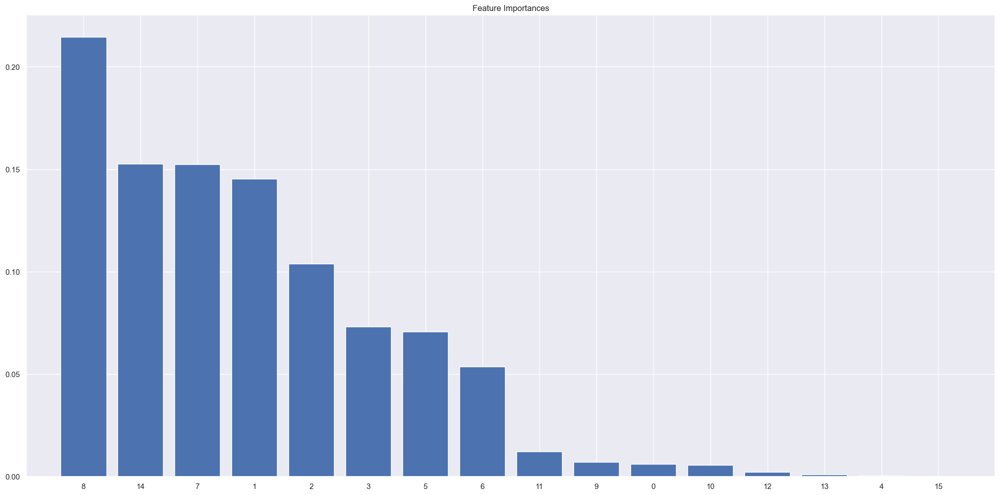

In [98]:
importances = forest.feature_importances_
indices = np.argsort(importances)[::-1]

# Print the features ranking
print('Features Ranking:')
df = pd.DataFrame()
for i, j in zip( x_train_n, forest.feature_importances_):
    aux = pd.DataFrame( {'feature':i, 'importance': j}, index=[0] )
    df = pd.concat( [df,aux], axis=0 )

print( df.sort_values( 'importance', ascending=False ))

# Plot the impurity-based feature importance of the forest
plt.figure()
plt.title("Feature Importances")
plt.bar(range(x_train_n.shape[1]), importances[indices], align='center')
plt.xticks( range(x_train_n.shape[1]), indices)
plt.xlim([-1, x_train_n.shape[1]])
plt.show()

In [99]:
cols_selected = ['vintage', 'annual_premium', 'age', 
                 'region_code', 'policy_sales_channel',
                 'vehicle_damage', 'previously_insured','response']

## 5.3. Train Test Split

In [100]:
X = df6[cols_selected].drop( ['response'], axis=1 )
y = df6['response']#.values

x_train, x_val, y_train, y_val = ms.train_test_split(X,y,test_size=0.30)

# 6.0. Machine Learning

## 6.1. Models

### 6.1.1. KNN Model

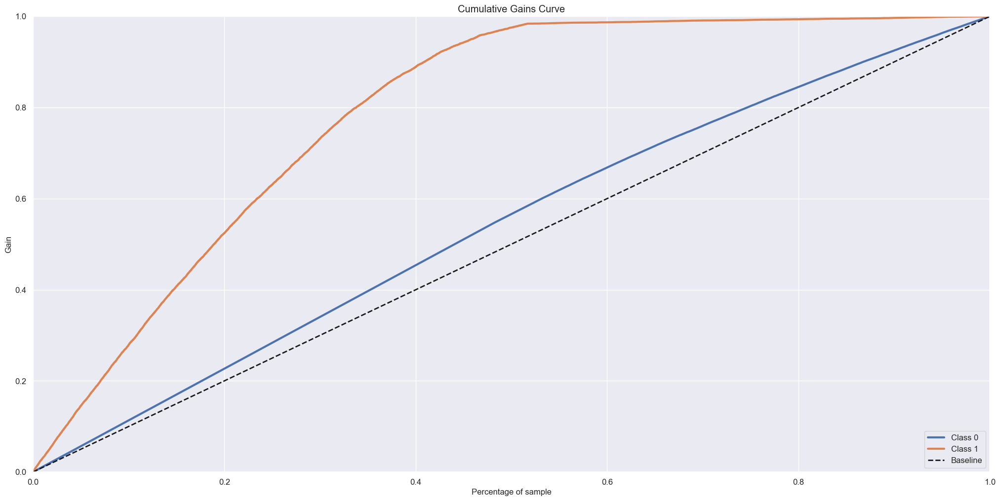

In [101]:
# model
knn_model25 = nb.KNeighborsClassifier( n_neighbors=25 )

# training

knn_model25.fit( x_train, y_train )

# model prediction - poder de GENERALIZAÇÃO
yhat_knn25 =knn_model25.predict_proba( x_val )

# Accumulative Gain lr
skplot.metrics.plot_cumulative_gain( y_val, yhat_knn25 );

### 6.1.2. Logistic Regression

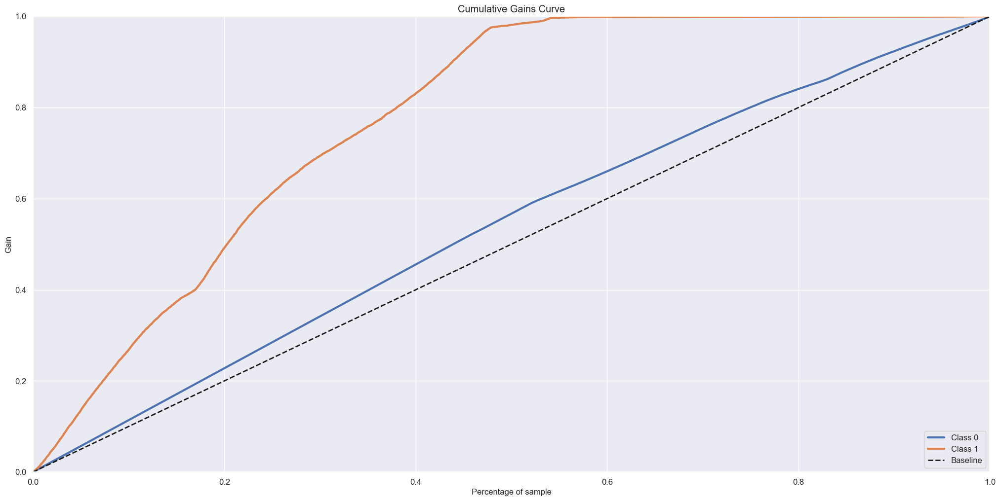

In [102]:
# model
lr_model = LogisticRegression()

# training
lr_model.fit( x_train, y_train )

# model prediction - poder de GENERALIZAÇÃO
yhat_lr =lr_model.predict_proba( x_val )

# Accumulative Gain lr
skplot.metrics.plot_cumulative_gain( y_val, yhat_lr );

### 6.1.3. Random Forest Classifier

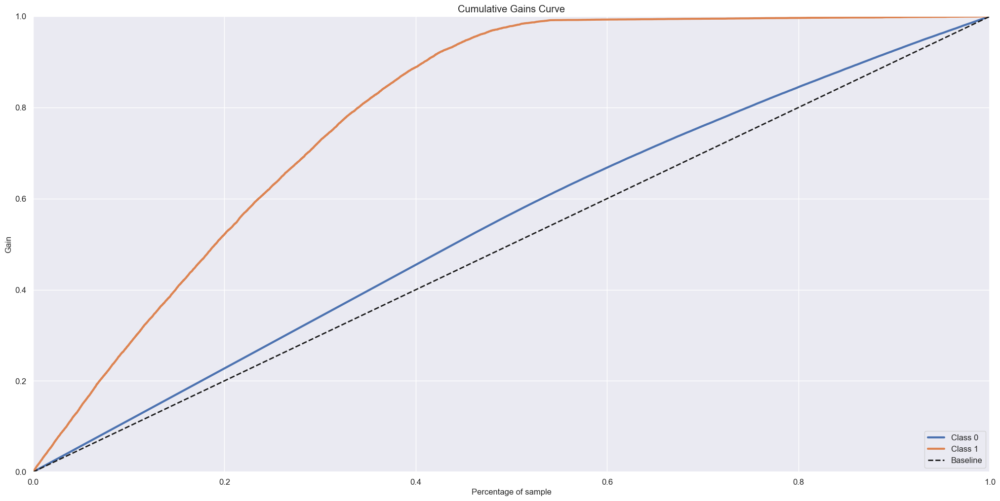

In [103]:
# model
rfc_model = RandomForestClassifier( n_estimators = 100, n_jobs = -1 )

# training
rfc_model.fit( x_train, y_train )

# model prediction - poder de GENERALIZAÇÃO
yhat_rfc =rfc_model.predict_proba( x_val )

# Accumulative Gain lr
skplot.metrics.plot_cumulative_gain( y_val, yhat_rfc );

In [104]:
#===========================
#  PRECISION AND RECALL @K
#===========================

def at_k( y_val, y_hat ):    
    
    df_metric = pd.DataFrame( y_val ) #response
    df_metric['predict'] = y_hat[:,1]
    df_metric = df_metric.sort_values( by='predict', ascending=False )
    df_metric['ranking'] = np.int64(np.linspace( 1, df_metric.shape[0], df_metric.shape[0]))
    df_metric = df_metric.assign( cumulative     = lambda x: (x['response'].cumsum() ) )
    df_metric = df_metric.assign( precision_at_k = lambda x: (x['cumulative']/df_metric['ranking'] ) )
    df_metric = df_metric.assign( recall_at_k    = lambda x: (x['cumulative']/df_metric['response'].sum() ) )
    #df_metric = df_metric.assign( recall_at_k    = lambda x: (x['cumulative']/( y_train.sum() ) ) )
    df_metric = df_metric.assign( baseline       = lambda x: (x['ranking']/df_metric.shape[0] ) )
    #df_metric = df_metric.assign( baseline       = lambda x: (x['ranking']/x_train.shape[0] ) )
    
    

    return df_metric

In [105]:
metrics_knn  = at_k( y_val, yhat_knn25 )
metrics_lr   = at_k( y_val, yhat_lr )
metrics_rfc  = at_k( y_val, yhat_rfc )

<AxesSubplot: xlabel='baseline', ylabel='precision_at_k'>

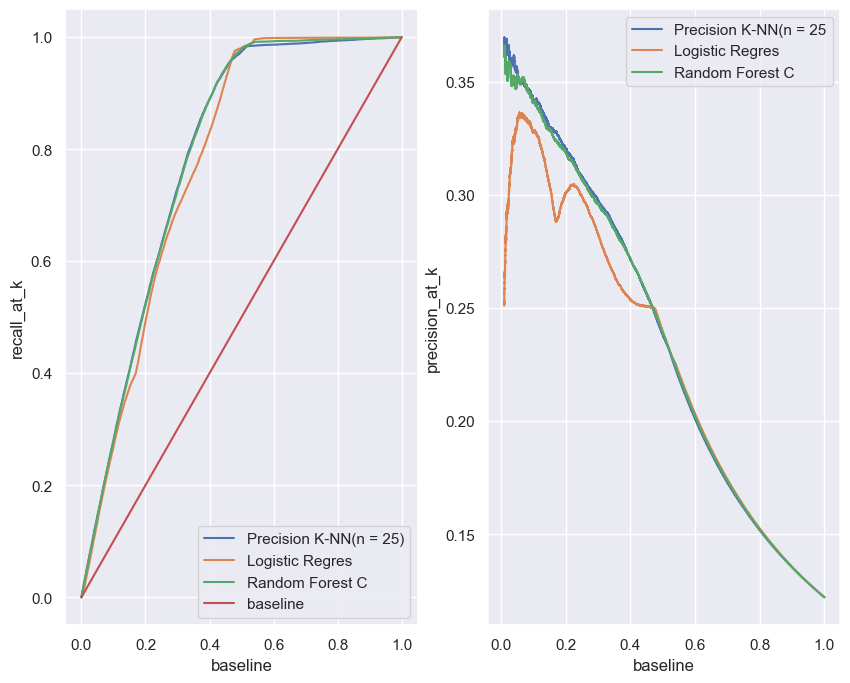

In [112]:
plt.figure(figsize=(10,8))
k = 20000
metrics_knn  = at_k( y_val, yhat_knn25 )
total = len(metrics_knn[metrics_knn['baseline']  >=0.05])

plt.subplot(1,2,1)
sns.lineplot(x='baseline', y='recall_at_k', data=metrics_knn     , label='Precision K-NN(n = 25)')
sns.lineplot(x='baseline', y='recall_at_k', data=metrics_lr      , label='Logistic Regres ')
sns.lineplot(x='baseline', y='recall_at_k', data=metrics_rfc     , label='Random Forest C')
sns.lineplot(x='baseline', y='baseline'   , data=metrics_lr     , label='baseline')

plt.subplot(1,2,2)
sns.lineplot(x='baseline', y='precision_at_k', data=metrics_knn[metrics_knn['baseline']  >=0.01]  , label='Precision K-NN(n = 25')
sns.lineplot(x='baseline', y='precision_at_k', data=metrics_lr[metrics_lr['baseline']    >=0.01]  , label='Logistic Regres ')
sns.lineplot(x='baseline', y='precision_at_k', data=metrics_rfc[metrics_rfc['baseline']  >=0.01]  , label='Random Forest C')

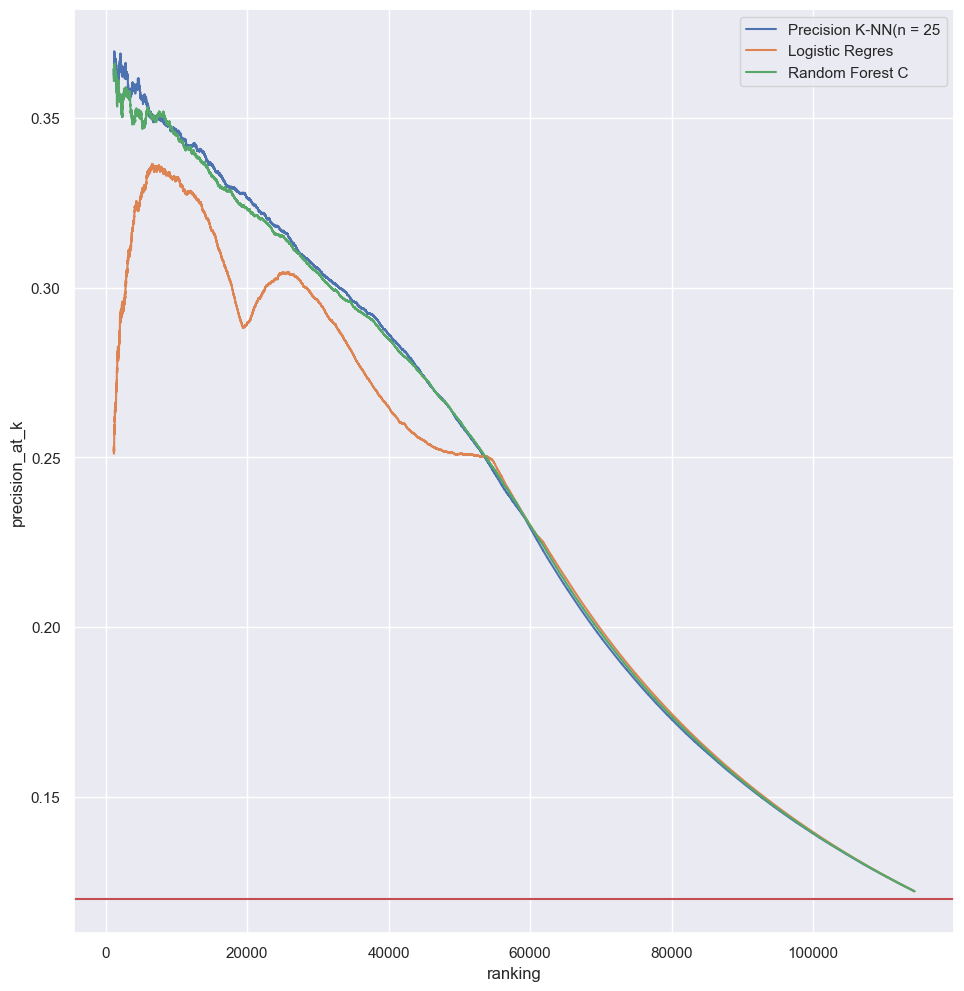

In [124]:
plt.subplot(1,2,1)
sns.lineplot(x='ranking', y='precision_at_k', data=metrics_knn[metrics_knn['baseline']  >=0.01]  , label='Precision K-NN(n = 25')
sns.lineplot(x='ranking', y='precision_at_k', data=metrics_lr[metrics_lr['baseline']    >=0.01]  , label='Logistic Regres ')
sns.lineplot(x='ranking', y='precision_at_k', data=metrics_rfc[metrics_rfc['baseline']  >=0.01]  , label='Random Forest C')
plt.axhline(.12, 0,1 ,color='r' )


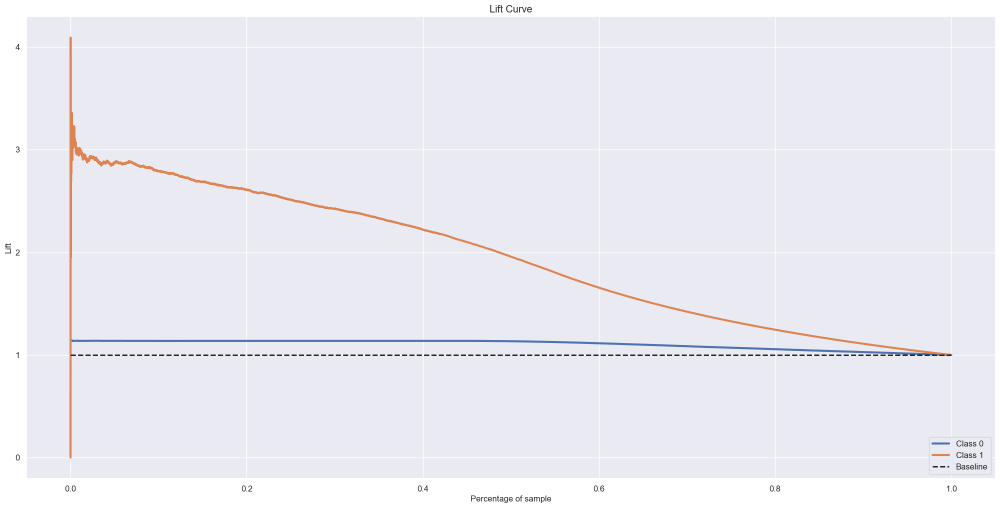

In [107]:
# lift curve
skplot.metrics.plot_lift_curve( y_val, yhat_rfc);

# 7.0. Crossvalidation

# 8.0. Hyper Parameters Tunning

# 9.0. Final Model

# 10.0. Model Deploy